In [1]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     | 38.4MB 506kB/s
     |████████████████████████████████| 81kB 1.8MB/s 
     |████████████████████████████████| 1.1MB 8.5MB/s 
     |████████████████████████████████| 3.2MB 19.7MB/s 
     |████████████████████████████████| 61kB 6.6MB/s 
     |████████████████████████████████| 81kB 8.5MB/s 
     |████████████████████████████████| 296kB 30.7MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.12.0-py2.py3-none-any.whl size=243829 sha256=e0597eddc0ad8460a2b0d0e12c166fbc1b2dfa305b2cd24601f584277b4cbbe6
  Stored in directory: /tmp/pip-ephem-wheel-cache-aka33ttf/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp37-none-any.whl size=27085 sha256=131b7d9f0787e19cd5c15b7d0e424878eae606efb591b264dd7a95ae4a685035
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for phik: filename=phik-0.11.2-cp37-none-any.whl size=1107413 sha256=3

In [2]:
import pandas as pd
import numpy as np
import math
import missingno as msno
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from pandas_profiling import ProfileReport
from google.colab import drive

In [3]:
drive.mount('/content/gdrive')
df_train = pd.read_csv('/content/gdrive/My Drive/Colab Notebooks/dataset/finalproject_sanbercode/train.csv')
df_test = pd.read_csv('/content/gdrive/My Drive/Colab Notebooks/dataset/finalproject_sanbercode/test.csv')

Mounted at /content/gdrive


# **Exploratory Data Analysis**

In [4]:
df_train

,index,daya_baterai,bluetooth,kecepatan_clock,dual_sim,kamera_depan,four_g,memori_internal,tebal_hp,berat_hp,jumlah_prosesor,kamera_belakang_mp,px_panjang,px_lebar,kapasitas_ram,panjang_layar,lebar_layar,waktu_telfon,three_g,touch_screen,wifi,price_range
0,1045,531,0,1.1,0,10,Tidak,63,0.7,189,7,14,145,1903,2958,17.0,1,19,0,1,0,2000k-3000k
1,937,764,1,1.2,1,1,Tidak,13,1.0,152,8,2,361,511,3148,18.0,7,6,1,1,0,2000k-3000k
2,1658,1812,1,1.3,1,4,Ya,42,1.0,162,7,15,380,1550,3338,18.0,13,11,1,1,1,>3000k
3,529,1821,0,0.9,0,9,Ya,12,0.3,114,1,18,97,1803,2430,7.0,4,6,1,1,1,2000k-3000k
4,895,1790,1,2.3,1,3,Ya,49,0.5,100,3,11,396,1980,3568,6.0,2,18,1,0,1,>3000k
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,835,1224,1,1.6,0,9,Tidak,33,1.0,157,1,18,522,563,3796,10.0,5,13,1,1,0,>3000k
1496,1216,1158,0,0.7,1,1,Ya,29,0.7,123,2,20,311,1796,1542,17.0,9,15,1,0,1,1000k-<2000k
1497,1653,1190,0,2.0,1,0,Tidak,40,0.2,93,5,1,1399,1646,3610,13.0,7,9,0,0,1,>3000k
1498,559,1191,0,2.4,1,2,Tidak,13,0.9,169,1,7,179,1813,1028,14.0,6,8,1,1,1,0-<1000k


In [ ]:
df_test

,index,daya_baterai,bluetooth,kecepatan_clock,dual_sim,kamera_depan,four_g,memori_internal,tebal_hp,berat_hp,jumlah_prosesor,kamera_belakang_mp,px_panjang,px_lebar,kapasitas_ram,panjang_layar,lebar_layar,waktu_telfon,three_g,touch_screen,wifi
0,405,1454,1,0.5,1,1,Tidak,34,0.7,83,4,3,250,1033,3419,7,5,5,1,1,0
1,1190,1092,1,0.5,1,10,Tidak,11,0.5,167,3,14,468,571,737,14,4,11,0,1,0
2,1132,1524,1,1.8,1,0,Tidak,10,0.6,174,4,1,154,550,2678,16,5,13,1,0,1
3,731,1807,1,2.1,0,2,Tidak,49,0.8,125,1,10,337,1384,1906,17,13,13,0,1,1
4,1754,1086,1,1.7,1,0,Ya,43,0.2,111,6,1,56,1150,3285,11,5,17,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,936,805,0,0.8,0,1,Tidak,34,0.6,88,6,2,1262,1538,3647,18,11,9,1,0,1
496,1524,1162,0,1.0,0,0,Tidak,50,0.5,104,4,10,332,866,1404,10,3,15,1,1,1
497,1415,1759,1,1.4,0,10,Ya,15,0.4,101,4,13,382,1163,2107,18,5,16,1,1,0
498,1223,514,1,1.6,0,7,Ya,37,0.1,172,1,9,956,1723,3392,12,8,5,1,1,1


In [ ]:
df_train.describe()

,index,daya_baterai,bluetooth,kecepatan_clock,dual_sim,kamera_depan,memori_internal,tebal_hp,berat_hp,jumlah_prosesor,kamera_belakang_mp,px_panjang,px_lebar,kapasitas_ram,panjang_layar,lebar_layar,waktu_telfon,three_g,touch_screen,wifi
count,1500.000000,1500.000000,1500.000000,1450.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1381.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000
mean,1005.632667,1233.106667,0.488000,1.547310,0.514000,4.188000,31.952667,0.501467,139.175333,4.526667,9.790667,656.468000,1263.966667,2101.494667,12.370022,5.840000,11.031333,0.760000,0.494667,0.514000
std,575.773812,441.849570,0.500023,0.833468,0.499971,4.243976,18.323853,0.288352,35.087225,2.274952,6.054250,445.909214,434.283017,1073.742748,4.351904,4.407647,5.479876,0.427226,0.500138,0.499971
min,0.000000,501.000000,0.000000,0.500000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,0.000000,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000
25%,509.750000,840.750000,0.000000,0.700000,0.000000,1.000000,16.000000,0.200000,108.000000,3.000000,4.000000,293.000000,882.000000,1202.500000,8.000000,2.000000,6.000000,1.000000,0.000000,0.000000
50%,1005.000000,1222.500000,0.000000,1.600000,1.000000,3.000000,31.000000,0.500000,139.000000,4.000000,10.000000,580.500000,1263.000000,2107.000000,13.000000,5.000000,11.000000,1.000000,0.000000,1.000000
75%,1509.250000,1608.500000,1.000000,2.300000,1.000000,7.000000,48.000000,0.800000,169.000000,7.000000,15.000000,961.000000,1645.250000,2982.250000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000
max,1998.000000,1998.000000,1.000000,3.000000,1.000000,16.000000,64.000000,1.000000,200.000000,8.000000,20.000000,1920.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000


In [ ]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 21 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   index               500 non-null    int64  
 1   daya_baterai        500 non-null    int64  
 2   bluetooth           500 non-null    int64  
 3   kecepatan_clock     500 non-null    float64
 4   dual_sim            500 non-null    int64  
 5   kamera_depan        500 non-null    int64  
 6   four_g              500 non-null    object 
 7   memori_internal     500 non-null    int64  
 8   tebal_hp            500 non-null    float64
 9   berat_hp            500 non-null    int64  
 10  jumlah_prosesor     500 non-null    int64  
 11  kamera_belakang_mp  500 non-null    int64  
 12  px_panjang          500 non-null    int64  
 13  px_lebar            500 non-null    int64  
 14  kapasitas_ram       500 non-null    int64  
 15  panjang_layar       500 non-null    int64  
 16  lebar_la

In [ ]:
profile = ProfileReport(df_train, title='Pandas Profiling Report', explorative=True)

In [ ]:
profile

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
profile2 = ProfileReport(df_test, title='Pandas Profiling Report Test', explorative=True)

In [6]:
profile2

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## **Visualisasi Matrix Missing Value**

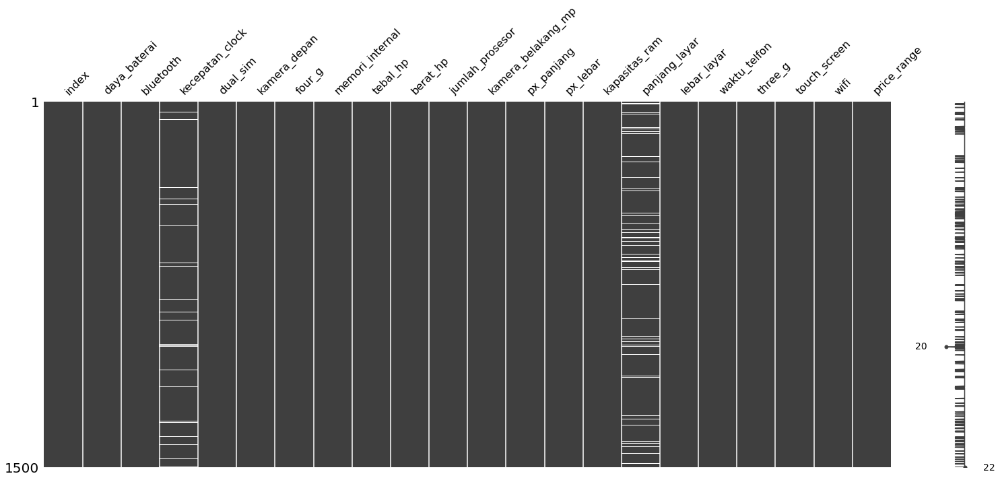

In [7]:
msno.matrix(df_train.sample(1500))

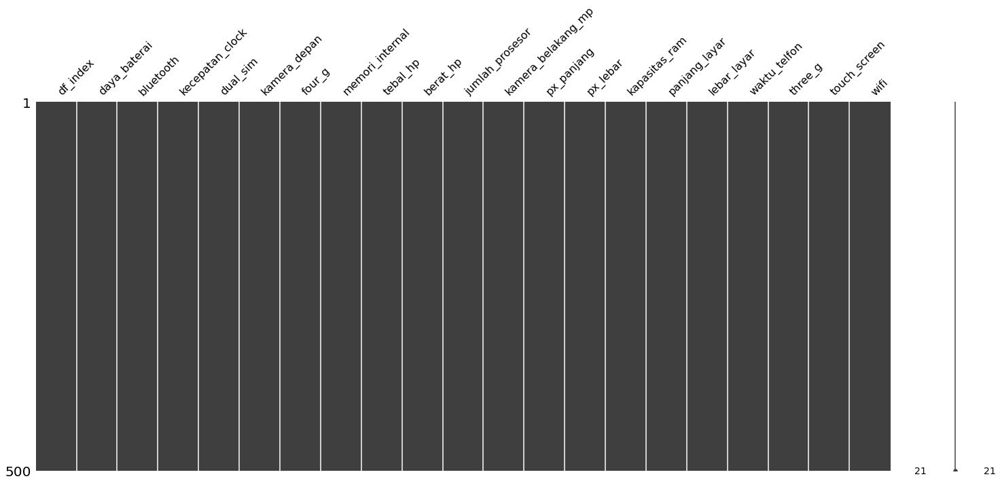

In [8]:
msno.matrix(df_test.sample(500))

In [9]:
def null_table(training, testing):
  print("Training Data Frame")
  print(pd.isnull(training).sum())
  print(" ")
  print("Testing Data Frame")
  print(pd.isnull(testing).sum())

null_table(df_train, df_test)

Training Data Frame
index                   0
daya_baterai            0
bluetooth               0
kecepatan_clock        50
dual_sim                0
kamera_depan            0
four_g                  0
memori_internal         0
tebal_hp                0
berat_hp                0
jumlah_prosesor         0
kamera_belakang_mp      0
px_panjang              0
px_lebar                0
kapasitas_ram           0
panjang_layar         119
lebar_layar             0
waktu_telfon            0
three_g                 0
touch_screen            0
wifi                    0
price_range             0
dtype: int64
 
Testing Data Frame
df_index              0
daya_baterai          0
bluetooth             0
kecepatan_clock       0
dual_sim              0
kamera_depan          0
four_g                0
memori_internal       0
tebal_hp              0
berat_hp              0
jumlah_prosesor       0
kamera_belakang_mp    0
px_panjang            0
px_lebar              0
kapasitas_ram         0
panjang_layar 

## **Pairplot**

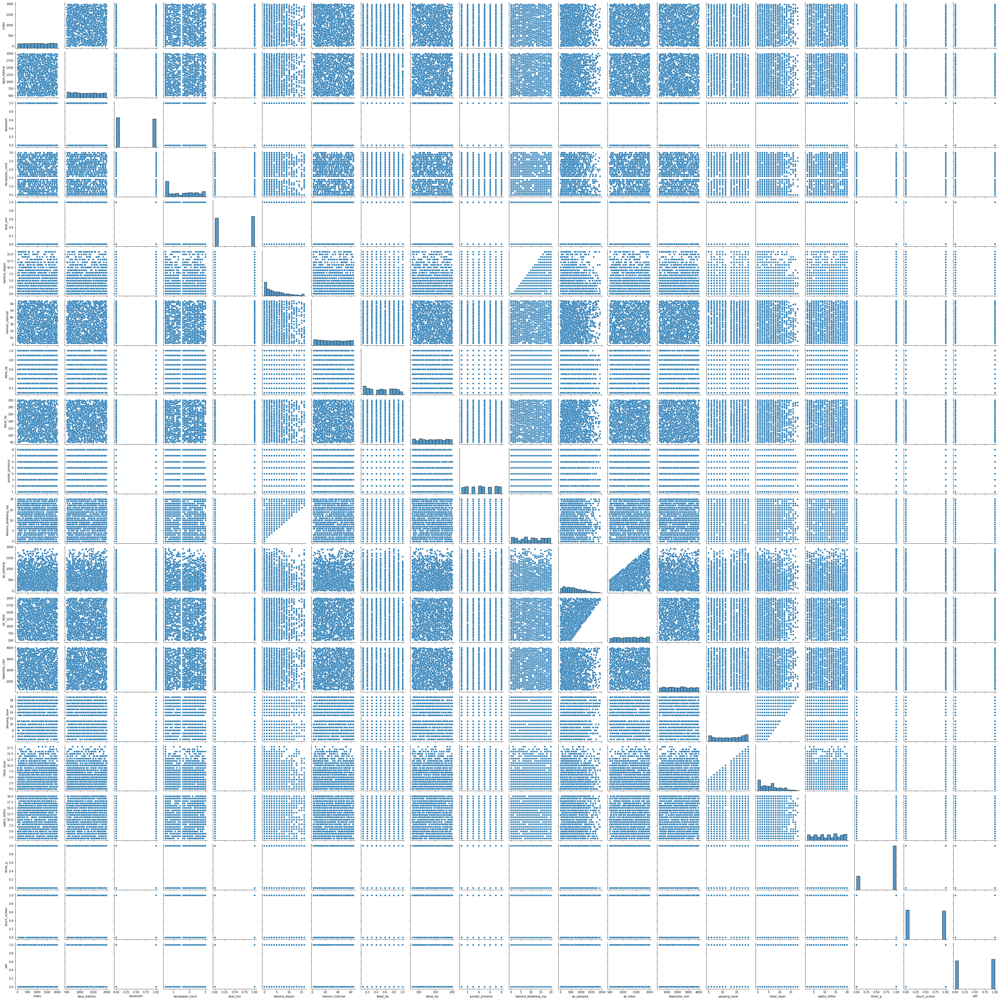

In [10]:
sns.pairplot(df_train)

In [15]:
df_train.columns

Index(['index', 'daya_baterai', 'bluetooth', 'kecepatan_clock', 'dual_sim',
       'kamera_depan', 'four_g', 'memori_internal', 'tebal_hp', 'berat_hp',
       'jumlah_prosesor', 'kamera_belakang_mp', 'px_panjang', 'px_lebar',
       'kapasitas_ram', 'panjang_layar', 'lebar_layar', 'waktu_telfon',
       'three_g', 'touch_screen', 'wifi', 'price_range'],
      dtype='object')

## **Encoding Data**

In [21]:
df_train['four_g'] = df_train['four_g'].replace({'Tidak':0, 'Ya':1})
df_test['four_g'] = df_test['four_g'].replace({'Tidak':0, 'Ya':1})
#df_train['price_range'] = df_train['price_range'].replace({'0-<1000k':0, '1000k-<2000k':1, '2000k-3000k':2,'>3000k':3})

In [22]:
le_price = LabelEncoder()
le_price.fit(df_train['price_range'])
encode_price_train = le_price.transform(df_train['price_range'])
df_train['price_range'] = encode_price_train 

In [23]:
df_train.head()

,index,daya_baterai,bluetooth,kecepatan_clock,dual_sim,kamera_depan,four_g,memori_internal,tebal_hp,berat_hp,jumlah_prosesor,kamera_belakang_mp,px_panjang,px_lebar,kapasitas_ram,panjang_layar,lebar_layar,waktu_telfon,three_g,touch_screen,wifi,price_range
0,1045,531,0,1.1,0,10,0,63,0.7,189,7,14,145,1903,2958,17.0,1,19,0,1,0,2
1,937,764,1,1.2,1,1,0,13,1.0,152,8,2,361,511,3148,18.0,7,6,1,1,0,2
2,1658,1812,1,1.3,1,4,1,42,1.0,162,7,15,380,1550,3338,18.0,13,11,1,1,1,3
3,529,1821,0,0.9,0,9,1,12,0.3,114,1,18,97,1803,2430,7.0,4,6,1,1,1,2
4,895,1790,1,2.3,1,3,1,49,0.5,100,3,11,396,1980,3568,6.0,2,18,1,0,1,3


## **Imputasi Data**

**Jika Menggunakan Imputer**

In [ ]:
from sklearn.impute import KNNImputer
imp = KNNImputer(n_neighbors=7)
df_train['panjang_layar']=imp.fit_transform(df_train['panjang_layar'][:, np.newaxis])
df_train['kecepatan_clock']=imp.fit_transform(df_train['kecepatan_clock'][:, np.newaxis])

#df_train = pd.DataFrame(imp.fit_transform(df_train),columns=df_train.columns)
#df_test = pd.DataFrame(imp.fit_transform(df_test),columns=df_test.columns)

<ipython-input-105-197027996355>:5: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  df_train['panjang_layar']=imp.fit_transform(df_train['panjang_layar'][:, np.newaxis])


**Jika Menggunakan fillna**

In [24]:
df_train['kecepatan_clock'] = df_train['kecepatan_clock'].fillna(df_train['kecepatan_clock'].mean())
df_test['kecepatan_clock'] = df_test['kecepatan_clock'].fillna(df_test['kecepatan_clock'].mean())

df_train['panjang_layar'] = df_train['panjang_layar'].fillna(df_train['panjang_layar'].mean())
df_test['panjang_layar'] = df_test['panjang_layar'].fillna(df_test['panjang_layar'].mean())

#df_train['lebar_layar'] = df_train['lebar_layar'].replace({0:math.floor(df_train['lebar_layar'].mean())})
#df_test['lebar_layar'] = df_test['lebar_layar'].replace({0:math.floor(df_test['lebar_layar'].mean())})

#df_train.drop(df_train[df_train.lebar_layar == 0])
#df_test.drop(df_test[df_test.lebar_layar == 0])

In [25]:
null_table(df_train, df_test)

Training Data Frame
index                 0
daya_baterai          0
bluetooth             0
kecepatan_clock       0
dual_sim              0
kamera_depan          0
four_g                0
memori_internal       0
tebal_hp              0
berat_hp              0
jumlah_prosesor       0
kamera_belakang_mp    0
px_panjang            0
px_lebar              0
kapasitas_ram         0
panjang_layar         0
lebar_layar           0
waktu_telfon          0
three_g               0
touch_screen          0
wifi                  0
price_range           0
dtype: int64
 
Testing Data Frame
df_index              0
daya_baterai          0
bluetooth             0
kecepatan_clock       0
dual_sim              0
kamera_depan          0
four_g                0
memori_internal       0
tebal_hp              0
berat_hp              0
jumlah_prosesor       0
kamera_belakang_mp    0
px_panjang            0
px_lebar              0
kapasitas_ram         0
panjang_layar         0
lebar_layar           0
waktu_telf

## **Seleksi Data Feature dan Target**

In [26]:
X = df_train.drop(['price_range'],axis=1)
y = df_train['price_range']

## **Data Scalling**

In [27]:
from sklearn.preprocessing import StandardScaler

cols = X.columns
cols2 =  df_test.columns

scaler = StandardScaler()
X = scaler.fit_transform(X)
X_testz = scaler.transform(df_test)

X = pd.DataFrame(X, columns=cols)
X_testz = pd.DataFrame(X_testz, columns=cols2)

In [ ]:
X.iloc[:, :].values

array([[1.045e+03, 5.310e+02, 0.000e+00, ..., 0.000e+00, 1.000e+00,
        0.000e+00],
       [9.370e+02, 7.640e+02, 1.000e+00, ..., 1.000e+00, 1.000e+00,
        0.000e+00],
       [1.658e+03, 1.812e+03, 1.000e+00, ..., 1.000e+00, 1.000e+00,
        1.000e+00],
       ...,
       [1.653e+03, 1.190e+03, 0.000e+00, ..., 0.000e+00, 0.000e+00,
        1.000e+00],
       [5.590e+02, 1.191e+03, 0.000e+00, ..., 1.000e+00, 1.000e+00,
        1.000e+00],
       [6.840e+02, 7.060e+02, 0.000e+00, ..., 1.000e+00, 0.000e+00,
        1.000e+00]])

In [ ]:
X

,index,daya_baterai,bluetooth,kecepatan_clock,dual_sim,kamera_depan,four_g,memori_internal,tebal_hp,berat_hp,...,kamera_belakang_mp,px_panjang,px_lebar,kapasitas_ram,panjang_layar,lebar_layar,waktu_telfon,three_g,touch_screen,wifi
0,1045,531,0,1.1,0,10,0,63,0.7,189,...,14,145,1903,2958,17.0,1.0,19,0,1,0
1,937,764,1,1.2,1,1,0,13,1.0,152,...,2,361,511,3148,18.0,7.0,6,1,1,0
2,1658,1812,1,1.3,1,4,1,42,1.0,162,...,15,380,1550,3338,18.0,13.0,11,1,1,1
3,529,1821,0,0.9,0,9,1,12,0.3,114,...,18,97,1803,2430,7.0,4.0,6,1,1,1
4,895,1790,1,2.3,1,3,1,49,0.5,100,...,11,396,1980,3568,6.0,2.0,18,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,835,1224,1,1.6,0,9,0,33,1.0,157,...,18,522,563,3796,10.0,5.0,13,1,1,0
1496,1216,1158,0,0.7,1,1,1,29,0.7,123,...,20,311,1796,1542,17.0,9.0,15,1,0,1
1497,1653,1190,0,2.0,1,0,0,40,0.2,93,...,1,1399,1646,3610,13.0,7.0,9,0,0,1
1498,559,1191,0,2.4,1,2,0,13,0.9,169,...,7,179,1813,1028,14.0,6.0,8,1,1,1


In [ ]:
y

0       2
1       2
2       3
3       2
4       3
       ..
1495    3
1496    1
1497    3
1498    0
1499    1
Name: price_range, Length: 1500, dtype: int32

In [ ]:
X_testz

,index,daya_baterai,bluetooth,kecepatan_clock,dual_sim,kamera_depan,four_g,memori_internal,tebal_hp,berat_hp,...,kamera_belakang_mp,px_panjang,px_lebar,kapasitas_ram,panjang_layar,lebar_layar,waktu_telfon,three_g,touch_screen,wifi
0,-1.043523,0.500096,1.024295,-1.273799,0.972381,-0.751433,-1.033908,0.111768,0.688741,-1.601554,...,-1.122010,-0.911853,-0.532012,1.227431,-1.280646,-0.190641,-1.101000,0.561951,1.010724,-1.028403
1,0.320315,-0.319461,1.024295,-1.273799,0.972381,1.369927,-1.033908,-1.143845,-0.005088,0.793279,...,0.695501,-0.422801,-1.596189,-1.271207,0.384767,-0.417596,-0.005720,-1.779513,1.010724,-1.028403
2,0.219547,0.658573,1.024295,0.310138,0.972381,-0.987140,-1.033908,-1.198437,0.341826,0.992848,...,-1.452467,-1.127215,-1.644561,0.537091,0.860599,-0.190641,0.359374,0.561951,-0.989390,0.972381
3,-0.477139,1.299276,1.024295,0.675662,-1.028403,-0.515726,-1.033908,0.930646,1.035656,-0.404137,...,0.034588,-0.716681,0.276486,-0.182129,1.098515,1.624991,0.359374,-1.779513,1.010724,0.972381
4,1.300193,-0.333045,1.024295,0.188297,0.972381,-0.987140,0.967204,0.603095,-1.045832,-0.803276,...,-1.452467,-1.347064,-0.262512,1.102592,-0.328981,-0.190641,1.089561,0.561951,1.010724,-1.028403
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,-0.120978,-0.969220,-0.976281,-0.908275,-1.028403,-0.751433,-1.033908,0.111768,0.341826,-1.459004,...,-1.287239,1.358424,0.631212,1.439843,1.336432,1.171083,-0.370813,0.561951,-0.989390,0.972381
496,0.900597,-0.160983,-0.976281,-0.664592,-1.028403,-0.987140,-1.033908,0.985238,-0.005088,-1.002845,...,0.034588,-0.727898,-0.916682,-0.649809,-0.566898,-0.644550,0.724467,0.561951,1.010724,0.972381
497,0.711223,1.190606,1.024295,-0.177227,-1.028403,1.369927,0.967204,-0.925478,-0.352003,-1.088375,...,0.530273,-0.615730,-0.232568,0.005129,1.336432,-0.190641,0.907014,0.561951,1.010724,-1.028403
498,0.377648,-1.628035,1.024295,0.066456,-1.028403,0.662807,0.967204,0.275543,-1.392746,0.935828,...,-0.130641,0.671957,1.057344,1.202277,-0.091065,0.490221,-1.101000,0.561951,1.010724,0.972381


# **Modelling Data**

Dalam pencarian model terbaik saya menggunakan modelling dengan RandomizedSCV terlebih dahulu dikarenakan untuk mempersingkat waktu dengan parameter yang cukup banyak. Kemudian dari parameter model RandomizedSCV tersebut akan di explore lagi menggunakan GridSearchCV dengan parameter menggabungkan parameter model dengan beberapa parameter baru yang tidak terlalu banyak.

Model Yang Digunakan:

1. RandomForest
2. SVC
3. XGBoost
4. Logistic Regression

In [28]:
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.metrics import accuracy_score, log_loss
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression

<AxesSubplot:title={'center':'Classifier Accuracy'}, xlabel='Accuracy', ylabel='Classifier'>

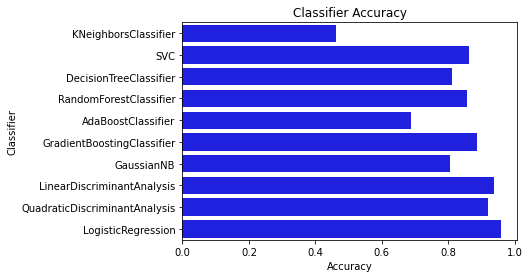

In [ ]:
classifiers = [
               KNeighborsClassifier(3),
               SVC(probability=True),
               DecisionTreeClassifier(),
               RandomForestClassifier(),
               AdaBoostClassifier(),
               GradientBoostingClassifier(),
               GaussianNB(),
               LinearDiscriminantAnalysis(),
               QuadraticDiscriminantAnalysis(),
               LogisticRegression()]

log_cols = ["Classifier", "Accuracy"]
log = pd.DataFrame(columns=log_cols)

sss = StratifiedShuffleSplit(n_splits=10, test_size=0.1, random_state=0)

X= X.iloc[:, :].values
y = y.values

acc_dict = {}

for train_index, test_index in sss.split(X, y):
  X_train, X_test = X[train_index], X[test_index]
  y_train, y_test = y[train_index], y[test_index]

  for clf in classifiers:
    name = clf.__class__.__name__
    clf.fit(X_train, y_train)
    train_predictions = clf.predict(X_test)
    acc = accuracy_score(y_test, train_predictions)
    if name in acc_dict:
      acc_dict[name] += acc
    else:
      acc_dict[name] = acc

for clf in acc_dict:
  acc_dict[clf] = acc_dict[clf] / 10.0
  log_entry = pd.DataFrame([[clf, acc_dict[clf]]], columns=log_cols)
  log = log.append(log_entry)

plt.xlabel('Accuracy')
plt.title('Classifier Accuracy')

sns.barplot(x='Accuracy', y='Classifier', data=log, color='b')

## **RandomForest**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, f1_score
from sklearn.model_selection import RandomizedSearchCV, train_test_split

model_rf= RandomForestClassifier()
param_grid = {'n_estimators':[100,200,300,400,500],
              'criterion':['gini','entropy'],
              'max_features':['auto','sqrt','log2'],
              'max_depth':np.arange(1,21),
              'bootstrap':[True,False],
              'min_samples_split':np.arange(2,11),
              'class_weight':['balanced', 'balanced_subsample'],
              'min_samples_leaf':np.arange(1,6)}

rscv = RandomizedSearchCV(model_rf, param_grid,n_iter=20, cv=10, scoring="f1_micro")
rscv.fit(X,y)

RandomizedSearchCV(cv=10, estimator=RandomForestClassifier(), n_iter=20,
                   param_distributions={'bootstrap': [True, False],
                                        'class_weight': ['balanced',
                                                         'balanced_subsample'],
                                        'criterion': ['gini', 'entropy'],
                                        'max_depth': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20]),
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': array([1, 2, 3, 4, 5]),
                                        'min_samples_split': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10]),
                                        'n_estimators': [100, 200, 300, 400,
                                                         500]},
                 

In [ ]:
rscv.best_params_

{'n_estimators': 400,
 'min_samples_split': 9,
 'min_samples_leaf': 2,
 'max_features': 'sqrt',
 'max_depth': 15,
 'criterion': 'entropy',
 'class_weight': 'balanced',
 'bootstrap': False}

In [ ]:
rscv.best_score_

0.8813333333333333

In [ ]:
model_rf = rscv.best_estimator_

In [ ]:
y_predict = model_rf.predict(X_testz)
y_predict

array([3, 0, 2, 1, 3, 0, 0, 3, 3, 1, 0, 3, 0, 2, 3, 0, 3, 2, 2, 1, 0, 0,
       3, 1, 1, 2, 3, 1, 3, 1, 1, 0, 1, 0, 2, 3, 0, 0, 3, 3, 2, 1, 3, 3,
       1, 3, 0, 1, 2, 1, 1, 3, 0, 3, 0, 2, 2, 1, 0, 3, 3, 1, 3, 2, 2, 3,
       3, 2, 1, 2, 3, 2, 1, 0, 1, 3, 2, 2, 2, 1, 3, 3, 3, 0, 0, 0, 2, 0,
       2, 3, 1, 3, 3, 0, 0, 2, 3, 3, 0, 3, 1, 2, 3, 1, 3, 1, 2, 3, 2, 3,
       3, 0, 0, 2, 2, 3, 0, 0, 1, 0, 0, 3, 2, 2, 1, 2, 1, 1, 0, 2, 1, 3,
       2, 3, 3, 3, 3, 1, 0, 1, 1, 2, 2, 3, 0, 3, 0, 0, 2, 0, 1, 1, 1, 1,
       3, 0, 0, 3, 1, 3, 2, 1, 3, 1, 2, 3, 3, 2, 1, 0, 3, 2, 2, 3, 3, 0,
       1, 2, 3, 0, 2, 1, 0, 1, 3, 1, 2, 0, 2, 3, 1, 1, 0, 2, 3, 0, 1, 2,
       1, 0, 3, 3, 3, 1, 1, 3, 3, 3, 0, 0, 0, 2, 3, 3, 0, 0, 1, 3, 2, 3,
       3, 3, 0, 0, 2, 2, 3, 2, 0, 2, 0, 0, 0, 3, 3, 0, 2, 2, 1, 1, 0, 2,
       3, 3, 0, 0, 1, 3, 3, 1, 3, 0, 3, 1, 1, 0, 1, 3, 3, 2, 0, 0, 1, 2,
       3, 2, 2, 3, 2, 1, 0, 3, 3, 2, 2, 3, 2, 2, 2, 1, 0, 2, 1, 1, 0, 0,
       2, 2, 2, 2, 0, 1, 3, 0, 1, 2, 3, 0, 2, 0, 1,

In [ ]:
submission = pd.DataFrame({'index':df_test['index'],
                           'price_range':y_predict})
submission.to_csv('test_gaji.csv', index=False)

## **Model SVC**

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import roc_auc_score, f1_score
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV , train_test_split

parameters = {
    "C": [0.1, 1.,3., 5.],
    "kernel": ["linear","poly", "rbf", "sigmoid"],
    "gamma": ["auto", "scale"],
    "degree": [1,5,10],
    "coef0": [0.0, 1.,3.,5.],
    "probability":[True,False],
    "class_weight":["balanced",None],
    "decision_function_shape":['ovo','ovr'],
}

model_svc = SVC(random_state=0)

#gscv = GridSearchCV(model_svc, parameters,verbose = 3, cv=10,scoring='f1_micro')
#gscv.fit(X, y)
rscv = RandomizedSearchCV(model_svc, parameters,n_iter=1000, cv=10, scoring="f1_micro",verbose = 3,error_score=0)
rscv.fit(X,y)

C:\Users\AZHAR IE\miniconda3\envs\myenv\lib\site-packages\sklearn\model_selection\_search.py:285: UserWarning: The total space of parameters 4 is smaller than n_iter=1000. Running 4 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
Fitting 10 folds for each of 4 candidates, totalling 40 fits
[CV 1/10] END C=1.0, class_weight=None, coef0=5.0, decision_function_shape=ovo, degree=10, gamma=scale, kernel=linear, probability=True; total time=   0.1s
[CV 2/10] END C=1.0, class_weight=None, coef0=5.0, decision_function_shape=ovo, degree=10, gamma=scale, kernel=linear, probability=True; total time=   0.2s
[CV 3/10] END C=1.0, class_weight=None, coef0=5.0, decision_function_shape=ovo, degree=10, gamma=scale, kernel=linear, probability=True; total time=   0.1s
[CV 4/10] END C=1.0, class_weight=None, coef0=5.0, decision_function_shape=ovo, degree=10, gamma=scale, kernel=linear, probability=True; total time=   0.1s
[CV 5/10] END C=1.0, class_weight=None, coef0=5.0, decision_f

RandomizedSearchCV(cv=10, error_score=0, estimator=SVC(), n_iter=1000,
                   param_distributions={'C': [1.0, 2.0, 3.0, 4.0],
                                        'class_weight': [None], 'coef0': [5.0],
                                        'decision_function_shape': ['ovo'],
                                        'degree': [10], 'gamma': ['scale'],
                                        'kernel': ['linear'],
                                        'probability': [True]},
                   scoring='f1_micro', verbose=3)

In [ ]:
gscv.best_params_

{'C': 1.0, 'gamma': 0.01, 'kernel': 'rbf'}

In [ ]:
gscv.best_score_

0.9026666666666667

In [ ]:
rscv.best_params_

{'probability': True,
 'kernel': 'linear',
 'gamma': 'scale',
 'degree': 10,
 'decision_function_shape': 'ovo',
 'coef0': 5.0,
 'class_weight': None,
 'C': 3.0}

In [ ]:
rscv.best_score_

0.9646666666666667

Score dan parameter 0.9653333333333333:

1. {'random_state': 0,
 'probability': True,
 'kernel': 'linear',
 'gamma': 'auto',
 'degree': 1,
 'decision_function_shape': 'ovr',
 'coef0': 0.0,
 'class_weight': None,
 'C': 3.0}

Score dan paramter 0.9646666666666667:

2. {'random_state': 0,
 'probability': False,
 'kernel': 'linear',
 'gamma': 'scale',
 'degree': 5,
 'decision_function_shape': 'ovr',
 'coef0': 3.0,
 'class_weight': None,
 'C': 3.0}

 3. {'probability': True,
 'kernel': 'linear',
 'gamma': 'scale',
 'degree': 10,
 'decision_function_shape': 'ovo',
 'coef0': 5.0,
 'class_weight': None,
 'C': 3.0}

In [ ]:
model_svc = gscv.best_estimator_

In [ ]:
model_svc = rscv.best_estimator_

In [ ]:
y_predict_svc = model_svc.predict(X_testz)
y_predict_svc

array([3, 0, 2, 2, 3, 0, 0, 3, 3, 1, 1, 3, 0, 2, 3, 0, 3, 2, 2, 1, 0, 0,
       3, 1, 2, 2, 3, 1, 3, 1, 1, 0, 2, 0, 1, 3, 0, 0, 3, 3, 3, 1, 3, 3,
       1, 3, 0, 1, 3, 1, 1, 3, 0, 3, 0, 2, 2, 2, 0, 3, 3, 1, 3, 2, 1, 2,
       3, 2, 2, 2, 3, 2, 1, 0, 1, 3, 2, 2, 1, 2, 3, 3, 3, 0, 0, 0, 2, 1,
       2, 3, 1, 2, 2, 1, 0, 3, 3, 3, 0, 3, 1, 1, 3, 1, 3, 2, 2, 3, 2, 3,
       3, 0, 0, 1, 3, 3, 0, 0, 1, 0, 0, 3, 2, 2, 1, 2, 1, 1, 0, 2, 1, 3,
       3, 3, 3, 3, 3, 2, 0, 1, 1, 2, 1, 3, 0, 3, 0, 0, 2, 0, 1, 1, 1, 1,
       3, 0, 0, 3, 1, 3, 2, 1, 3, 1, 2, 3, 3, 2, 1, 0, 3, 1, 2, 3, 3, 0,
       2, 2, 3, 0, 2, 1, 0, 1, 2, 1, 2, 0, 3, 3, 1, 1, 1, 2, 3, 0, 1, 2,
       2, 0, 3, 3, 3, 1, 2, 3, 3, 3, 0, 0, 0, 2, 3, 3, 0, 0, 1, 3, 2, 3,
       3, 3, 0, 0, 2, 2, 3, 1, 0, 2, 0, 0, 0, 3, 2, 0, 2, 2, 1, 1, 0, 2,
       3, 3, 0, 0, 1, 3, 3, 1, 3, 0, 3, 1, 1, 0, 2, 3, 3, 2, 0, 0, 1, 2,
       3, 2, 2, 3, 1, 1, 0, 3, 3, 2, 1, 3, 2, 2, 2, 1, 0, 2, 2, 1, 0, 0,
       2, 2, 2, 2, 0, 1, 3, 0, 2, 2, 3, 0, 2, 0, 1,

In [ ]:
submission = pd.DataFrame({'index':df_test['index'],
                           'price_range':y_predict_svc})
submission.to_csv('test_gaji12.csv', index=False)

## **Model XGBoost**

In [ ]:
import xgboost as xgb
from sklearn.metrics import roc_auc_score, f1_score
from sklearn.model_selection import GridSearchCV , train_test_split

parameters = {
    'max_depth': [3, 5, 7, 9, 10],
    'min_child_weight': [5], 
    'n_estimators': [5, 10, 15, 20, 25, 50, 100,500],
    'learning_rate': [0.01, 0.05, 0.1, 0.5, 1., 1.5,2.]
}

model_xgb = xgb.XGBClassifier(
    random_state=42, verbosity = 0,min_child_weight=1,subsample=0.8,colsample_bytree=0.8,nthread=4
)

gscv = GridSearchCV(model_xgb, parameters, cv=10,verbose = 3,scoring='f1_micro',)
gscv.fit(X,y)

In [ ]:
gscv.best_params_

In [ ]:
gscv.best_score_

In [ ]:
model_xgb = gscv.best_estimator_

In [ ]:
y_predict_xgb = model_xgb.predict(X_testz)
y_predict_xgb

## **Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

parameters = {
    "C": [1.,3.,5.,7.,9.],
    "penalty": ["l1", "l2",'elasticnet','none'],
    'multi_class':['auto', 'ovr', 'multinomial'],
    "solver":['newton-cg', 'lbfgs', 'liblinear','sag', 'saga'],
    "class_weight":['balanced', None, 'balanced_subsample'],
    'n_jobs':[-1, None,1,2,5],
    'fit_intercept' : [True, False],
    'intercept_scaling':[1,2],
    'warm_start':[True, False],
    'max_iter':[100,300,500]
}

model_logistic_regression = LogisticRegression(random_state=0)

#gscv = GridSearchCV(model_logistic_regression, parameters, cv=10,verbose = 3,scoring='f1_micro',error_score=0)
#gscv.fit(X, y)
rscv = RandomizedSearchCV(model_logistic_regression, parameters,n_iter=4000, cv=10,scoring="f1_micro", verbose = 3,error_score=0)
rscv.fit(X,y)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
[CV 1/10] END C=1.5, class_weight=None, fit_intercept=True, intercept_scaling=1, max_iter=1000, multi_class=multinomial, n_jobs=1, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   1.0s
[CV 2/10] END C=1.5, class_weight=None, fit_intercept=True, intercept_scaling=1, max_iter=1000, multi_class=multinomial, n_jobs=1, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   1.0s
[CV 3/10] END C=1.5, class_weight=None, fit_intercept=True, intercept_scaling=1, max_iter=1000, multi_class=multinomial, n_jobs=1, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.9s
[CV 4/10] END C=1.5, class_weight=None, fit_intercept=True, intercept_scaling=1, max_iter=1000, multi_class=multinomial, n_jobs=1, penalty=l1, solver=saga, tol=0.0001, warm_start=True; total time=   0.9s
[CV 5/10] END C=1.5, class_weight=None, fit_intercept=True, intercept_scaling=1, max_iter=1000, multi_class=multinomial, n_

GridSearchCV(cv=10, error_score=0, estimator=LogisticRegression(random_state=0),
             param_grid={'C': [1.5], 'class_weight': [None],
                         'fit_intercept': [True], 'intercept_scaling': [1],
                         'max_iter': [1000], 'multi_class': ['multinomial'],
                         'n_jobs': [1], 'penalty': ['l1'], 'solver': ['saga'],
                         'tol': [0.0001, 1e-05, 0.001, 0.0005, 5e-05],
                         'warm_start': [True]},
             scoring='f1_micro', verbose=3)

In [ ]:
gscv.best_params_

{'C': 1.5,
 'class_weight': None,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'max_iter': 1000,
 'multi_class': 'multinomial',
 'n_jobs': 1,
 'penalty': 'l1',
 'solver': 'saga',
 'tol': 0.0001,
 'warm_start': True}

In [ ]:
gscv.best_score_

0.9753333333333332

In [ ]:
rscv.best_params_

{'warm_start': True,
 'solver': 'saga',
 'penalty': 'l1',
 'n_jobs': -1,
 'multi_class': 'multinomial',
 'max_iter': 1000,
 'intercept_scaling': 1,
 'fit_intercept': True,
 'class_weight': None,
 'C': 1.5}

In [ ]:
rscv.best_score_

0.9753333333333332

Score dan parameter 0.9753333333333332:

1. {'warm_start': True,
 'solver': 'saga',
 'penalty': 'l1',
 'n_jobs': -1,
 'multi_class': 'multinomial',
 'max_iter': 1000,
 'intercept_scaling': 1,
 'fit_intercept': True,
 'class_weight': None,
 'C': 1.5}

Score dan parameter  0.9746666666666666:

2. {'warm_start': True,
 'solver': 'saga',
 'penalty': 'l1',
 'n_jobs': 1,
 'multi_class': 'multinomial',
 'max_iter': 500,
 'intercept_scaling': 1,
 'fit_intercept': True,
 'class_weight': 'balanced',
 'C': 3.0}

 3. {'warm_start': True,
 'solver': 'saga',
 'random_state': 21,
 'penalty': 'l1',
 'n_jobs': 2,
 'multi_class': 'auto',
 'max_iter': 300,
 'intercept_scaling': 2,
 'fit_intercept': True,
 'class_weight': None,
 'C': 3.0}

 4. {'warm_start': False,
 'solver': 'saga',
 'random_state': 0,
 'penalty': 'l1',
 'n_jobs': -1,
 'multi_class': 'auto',
 'max_iter': 300,
 'intercept_scaling': 2,
 'fit_intercept': True,
 'class_weight': None,
 'C': 3.0}

In [ ]:
model_logistic_regression = gscv.best_estimator_

In [ ]:
model_logistic_regression = rscv.best_estimator_

In [ ]:
y_predict_lg = model_logistic_regression.predict(X_testz)
y_predict_lg

array([3, 0, 2, 2, 2, 0, 0, 3, 3, 1, 1, 3, 0, 2, 3, 0, 3, 2, 2, 1, 0, 0,
       3, 1, 2, 2, 3, 1, 3, 1, 1, 0, 2, 0, 1, 3, 0, 0, 3, 3, 3, 1, 3, 3,
       1, 3, 0, 1, 3, 1, 1, 3, 0, 3, 0, 2, 2, 2, 0, 3, 3, 1, 3, 2, 1, 2,
       3, 2, 2, 2, 3, 2, 1, 0, 1, 3, 2, 2, 1, 2, 3, 3, 3, 0, 0, 0, 2, 1,
       2, 3, 1, 2, 2, 1, 0, 3, 3, 3, 0, 3, 1, 1, 3, 1, 3, 2, 2, 3, 2, 3,
       3, 0, 0, 1, 3, 3, 0, 0, 1, 0, 0, 3, 2, 2, 1, 2, 1, 1, 0, 2, 1, 3,
       3, 3, 3, 3, 3, 2, 0, 1, 1, 2, 1, 3, 0, 3, 0, 0, 2, 0, 1, 1, 1, 1,
       3, 1, 0, 3, 1, 3, 2, 1, 3, 1, 2, 3, 3, 2, 1, 0, 3, 1, 2, 3, 3, 0,
       2, 2, 3, 0, 2, 1, 0, 1, 2, 1, 2, 0, 3, 3, 1, 1, 0, 2, 3, 0, 1, 2,
       2, 0, 3, 3, 3, 1, 2, 3, 3, 3, 0, 0, 0, 2, 3, 3, 0, 0, 1, 3, 2, 3,
       3, 3, 0, 0, 2, 2, 3, 1, 0, 2, 0, 0, 0, 3, 2, 0, 2, 2, 1, 1, 0, 2,
       3, 3, 0, 0, 1, 3, 3, 1, 3, 0, 3, 1, 1, 0, 2, 3, 3, 2, 0, 0, 1, 2,
       3, 2, 2, 3, 2, 1, 0, 3, 3, 2, 1, 3, 2, 2, 2, 1, 0, 2, 2, 1, 0, 0,
       2, 2, 2, 2, 0, 1, 3, 0, 2, 2, 3, 0, 2, 0, 1,

In [ ]:
submission = pd.DataFrame({'index':df_test['index'],
                           'price_range':y_predict_lg})
submission.to_csv('test_gaji13.csv', index=False)

# **Membandingkan Model Lama dengan Model Baru**

Dikarenakan kaggle memiliki batas submit jadi untuk mengsubmit hasil prediksi terbaik digunakan hasil prediksi maka saya menggunakan fungsi dimana jika hasil prediksi model lama dan hasil prediksi model baru sama hasilnya maka saya tidak perlu submit model baru ke kaggle.

In [ ]:
predict_lama = np.array([3., 0., 2., 2., 2., 0., 0., 3., 3., 1., 1., 3., 0., 2., 3., 0., 3.,
       2., 2., 1., 0., 0., 3., 1., 2., 2., 3., 1., 3., 1., 1., 0., 2., 0.,
       1., 3., 0., 0., 3., 3., 3., 1., 3., 3., 1., 3., 0., 1., 3., 1., 1.,
       3., 0., 3., 0., 2., 2., 2., 0., 3., 3., 1., 3., 2., 1., 2., 3., 2.,
       2., 2., 3., 2., 1., 0., 1., 3., 2., 2., 1., 2., 3., 3., 3., 0., 0.,
       0., 2., 1., 2., 3., 1., 2., 2., 1., 0., 3., 3., 3., 0., 3., 1., 1.,
       3., 1., 3., 2., 2., 3., 2., 3., 3., 0., 0., 1., 3., 3., 0., 0., 1.,
       0., 0., 3., 2., 2., 1., 2., 1., 1., 0., 2., 1., 3., 3., 3., 3., 3.,
       3., 2., 0., 1., 1., 2., 1., 3., 0., 3., 0., 0., 2., 0., 1., 1., 1.,
       1., 3., 1., 0., 3., 1., 3., 2., 1., 3., 1., 2., 3., 3., 2., 1., 0.,
       3., 1., 2., 3., 3., 0., 2., 2., 3., 0., 2., 1., 0., 1., 2., 1., 2.,
       0., 3., 3., 1., 1., 0., 2., 3., 0., 1., 2., 2., 0., 3., 3., 3., 1.,
       2., 3., 3., 3., 0., 0., 0., 2., 3., 3., 0., 0., 1., 3., 2., 3., 3.,
       3., 0., 0., 2., 2., 3., 1., 0., 2., 0., 0., 0., 3., 2., 0., 2., 2.,
       1., 1., 0., 2., 3., 3., 0., 0., 1., 3., 3., 1., 3., 0., 3., 1., 1.,
       0., 2., 3., 3., 2., 0., 0., 1., 2., 3., 2., 2., 3., 2., 1., 0., 3.,
       3., 2., 1., 3., 2., 2., 2., 1., 0., 2., 2., 1., 0., 0., 2., 2., 2.,
       2., 0., 1., 3., 0., 2., 2., 3., 0., 2., 0., 1., 1., 3., 0., 0., 2.,
       3., 1., 2., 0., 2., 0., 3., 0., 3., 3., 2., 3., 1., 2., 2., 1., 1.,
       1., 0., 1., 0., 3., 1., 0., 3., 0., 0., 1., 3., 0., 3., 1., 1., 0.,
       1., 3., 0., 2., 2., 1., 2., 1., 1., 0., 2., 0., 0., 3., 1., 2., 3.,
       2., 2., 0., 3., 2., 2., 1., 3., 2., 3., 3., 3., 0., 2., 0., 3., 0.,
       1., 1., 2., 2., 1., 3., 1., 2., 0., 1., 2., 3., 0., 0., 1., 3., 0.,
       3., 0., 2., 2., 1., 1., 0., 2., 0., 0., 1., 3., 0., 3., 3., 0., 2.,
       1., 3., 1., 1., 3., 2., 0., 3., 2., 2., 0., 0., 3., 0., 1., 1., 1.,
       3., 2., 3., 2., 0., 3., 0., 0., 1., 3., 0., 0., 3., 2., 2., 2., 3.,
       0., 0., 1., 2., 1., 2., 0., 3., 3., 0., 3., 3., 0., 2., 2., 1., 0.,
       2., 2., 1., 3., 2., 2., 0., 2., 0., 3., 3., 2., 1., 0., 3., 1., 2.,
       0., 0., 1., 3., 0., 3., 0., 0., 1., 2., 0., 1., 3., 0., 2., 2., 1.,
       2., 0., 3., 0., 2., 3., 2.])

In [ ]:
predict_baru = np.array([3, 0, 2, 2, 2, 0, 0, 3, 3, 1, 1, 3, 0, 2, 3, 0, 3, 2, 2, 1, 0, 0,
       3, 1, 2, 2, 3, 1, 3, 1, 1, 0, 2, 0, 1, 3, 0, 0, 3, 3, 3, 1, 3, 3,
       1, 3, 0, 1, 3, 1, 1, 3, 0, 3, 0, 2, 2, 2, 0, 3, 3, 1, 3, 2, 1, 2,
       3, 2, 2, 2, 3, 2, 1, 0, 1, 3, 2, 2, 1, 2, 3, 3, 3, 0, 0, 0, 2, 1,
       2, 3, 1, 2, 2, 1, 0, 3, 3, 3, 0, 3, 1, 1, 3, 1, 3, 2, 2, 3, 2, 3,
       3, 0, 0, 1, 3, 3, 0, 0, 1, 0, 0, 3, 2, 2, 1, 2, 1, 1, 0, 2, 1, 3,
       3, 3, 3, 3, 3, 2, 0, 1, 1, 2, 1, 3, 0, 3, 0, 0, 2, 0, 1, 1, 1, 1,
       3, 1, 0, 3, 1, 3, 2, 1, 3, 1, 2, 3, 3, 2, 1, 0, 3, 1, 2, 3, 3, 0,
       2, 2, 3, 0, 2, 1, 0, 1, 2, 1, 2, 0, 3, 3, 1, 1, 0, 2, 3, 0, 1, 2,
       2, 0, 3, 3, 3, 1, 2, 3, 3, 3, 0, 0, 0, 2, 3, 3, 0, 0, 1, 3, 2, 3,
       3, 3, 0, 0, 2, 2, 3, 1, 0, 2, 0, 0, 0, 3, 2, 0, 2, 2, 1, 1, 0, 2,
       3, 3, 0, 0, 1, 3, 3, 1, 3, 0, 3, 1, 1, 0, 2, 3, 3, 2, 0, 0, 1, 2,
       3, 2, 2, 3, 2, 1, 0, 3, 3, 2, 1, 3, 2, 2, 2, 1, 0, 2, 2, 1, 0, 0,
       2, 2, 2, 2, 0, 1, 3, 0, 2, 2, 3, 0, 2, 0, 1, 1, 3, 0, 0, 2, 3, 1,
       2, 0, 2, 0, 3, 0, 3, 3, 2, 3, 1, 2, 2, 1, 1, 1, 0, 1, 0, 3, 1, 0,
       3, 0, 0, 1, 3, 0, 3, 1, 2, 0, 1, 3, 0, 2, 2, 1, 2, 1, 1, 0, 2, 0,
       0, 3, 1, 2, 3, 2, 2, 0, 3, 2, 2, 1, 3, 2, 3, 3, 3, 0, 2, 0, 3, 0,
       1, 1, 2, 2, 1, 3, 1, 2, 0, 1, 2, 3, 0, 0, 1, 3, 0, 3, 0, 2, 2, 1,
       1, 0, 2, 0, 0, 1, 3, 0, 3, 3, 0, 2, 1, 3, 1, 1, 3, 2, 0, 3, 2, 2,
       0, 0, 3, 0, 1, 1, 1, 3, 2, 3, 2, 0, 3, 0, 0, 1, 3, 0, 0, 3, 2, 2,
       2, 3, 0, 0, 1, 2, 1, 2, 0, 3, 3, 0, 3, 3, 0, 2, 2, 1, 0, 2, 2, 1,
       3, 2, 2, 0, 2, 0, 3, 3, 2, 1, 0, 3, 1, 2, 0, 0, 1, 3, 0, 3, 0, 0,
       1, 2, 0, 1, 3, 0, 2, 2, 1, 2, 0, 3, 0, 2, 3, 2])

In [ ]:
comparison = predict_lama == predict_baru
equal_arrays = comparison.all()
comparison

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,